In [1]:
import yaml
import cv2
import torch
import requests
import numpy as np
import gc
import torch.nn.functional as F
import pandas as pd
from matplotlib import cm
from scipy.stats import spearmanr

import torchvision.models as models
import torchvision.transforms as transforms

from PIL import Image
from IPython.display import display, HTML, clear_output
from ipywidgets import widgets, Layout
from io import BytesIO
from argparse import Namespace
from maskrcnn_benchmark.config import cfg
# from VQAtools.VQAtools.vqa import VQA
import json

In [113]:
question_type = 'MultipleChoice'
annot_path = 'model_data/mscoco_val2014_annotations.json'
questions_path = 'model_data/Questions_Val_mscoco/%s_mscoco_val2014_questions.json'%(question_type)

# note: image index = qid // 10
# indices to find question and answer by qid
questions_index = {}
# answers_index = {}
def build_index(questions_path, annot_path):
    questions = json.load(open(questions_path, 'r'))
    for ques in questions['questions']:
        questions_index[int(ques['question_id'])] = ques['question']
#         answers_index[int(ques['question_id'])] = int(ques['question'])
build_index(questions_path, annot_path)

def rank_corr_images(image1_path, image2_path):
    convert = transforms.Compose([transforms.ToTensor(), transforms.CenterCrop(448)])
    img1 = convert(Image.open(image1_path))
    img2 = convert(Image.open(image2_path))
    corr, p = spearmanr(torch.flatten(img1), torch.flatten(img2))
    return corr

In [105]:
hiecoatt_maps_dir = 'model_data/hiecoatt-val-att/p_att'
san2_maps_dir = 'model_data/san2-val-att/san2-1-val'
human_maps_dir = 'model_data/vqahat_val'
coco_images_dir = 'model_data/val2014'

def get_hiecoatt_map(qid):
    return '%s/%s.png'%(hiecoatt_maps_dir, qid)

def get_san2_map(qid):
    return '%s/%s.png'%(san2_maps_dir, qid)

def get_human_map(qid): # note: scale here seems to be 5/8 of coco image scale
#     qid = str(qid)[:-1] + '_' + str(qid+1)[-1] # uses 1-3 for last digit where others use 0-2
    qid = str(qid) + '_1' # always use n=1
    return '%s/%s.png'%(human_maps_dir, qid)

def get_coco_image(qid):
    image_id = qid // 10
    return '%s/COCO_val2014_%s.jpg'%(coco_images_dir, str(image_id).zfill(12)) # zero pad to 12 digits

questions = json.load(open(questions_path, 'r'))
answers = json.load(open(annot_path, 'r'))

def get_coco_question(qid):
    return questions(qid)

In [111]:
questions['questions']

AttributeError: 'list' object has no attribute 'keys'

In [145]:
def overlay_images(img, mask, colormap='jet', alpha=0.7):
    # normalize, resize mask and apply colormap
    cmap = cm.get_cmap(colormap)
    overlay = np.asarray(mask.resize(img.size, resample=Image.BICUBIC))
    overlay = overlay / overlay.max()
    overlay = (255 * cmap(np.asarray(overlay) ** 2)[:, :, :3]).astype(np.uint8)
    
    # overlay the image with the mask
    overlayed_img = Image.fromarray((alpha * np.asarray(img) + (1 - alpha) * overlay).astype(np.uint8))
    return overlayed_img

def compare_maps(qid):
    print('Question ID:', qid)
    print('Question:', questions_index[qid])
    print('HieCoAttentionVQA attention:')
    display(overlay_images(Image.open(get_coco_image(qid)), Image.open(get_hiecoatt_map(qid))))
    print('Rank correlation:', rank_corr_images(get_human_map(qid), get_hiecoatt_map(qid)))
    print('San2 attention:')
    display(overlay_images(Image.open(get_coco_image(qid)), Image.open(get_san2_map(qid))))
    print('Rank correlation:', rank_corr_images(get_human_map(qid), get_san2_map(qid)))
    print('Human attention:')
    display(overlay_images(Image.open(get_coco_image(qid)), Image.open(get_human_map(qid))))

In [118]:
# we want qids that have both a human map and are available in the validation dataset
# for some reason, there are some human maps whose corresponding question is not in our coco val dataset

# get list of images with human maps
from os import listdir
from os.path import isfile, join

human_map_files = [f for f in listdir(human_maps_dir) if isfile(join(human_maps_dir, f))]
human_map_qids = set([int(f[:-6]) for f in human_map_files])
print('# qids with human map:', len(human_map_qids))

coco_files = [f for f in listdir(coco_images_dir) if isfile(join(coco_images_dir, f))]
coco_qids = set([int(f.split('_')[2][:-4])*10 for f in coco_files])
print('# qids in coco val dataset:', len(coco_qids))

intersect_qids = coco_qids.intersection(human_map_qids)
print('# qids in both human map and coco val:', len(intersect_qids))

# now including human maps training dataset
human_maps_train_dir = 'model_data/vqahat_train'
human_map_train_files = [f for f in listdir(human_maps_train_dir) if isfile(join(human_maps_train_dir, f))]
human_map_train_qids = set([int(f[:-6]) for f in human_map_train_files])
print('# qids with human map:', len(human_map_train_qids))

print('# qids in both train human map and coco val:', len(coco_qids.intersection(human_map_train_qids)))

# sorted(list(intersect_qids))
# sorted(list(human_map_qids.difference(coco_qids)))

# qids with human map: 1374
# qids in coco val dataset: 40504
# qids in both human map and coco val: 462
# qids with human map: 58083
# qids in both train human map and coco val: 0


In [143]:
# looking at hiecoatt qids
hiecoatt_files = [f for f in listdir(hiecoatt_maps_dir) if isfile(join(hiecoatt_maps_dir, f))]
hiecoatt_files.remove('.DS_Store')
hiecoatt_qids = set([int(f[:-4]) for f in hiecoatt_files])
print('# qids in hiecoatt dataset:', len(hiecoatt_qids))

# looking at san2 qids
san2_files = [f for f in listdir(san2_maps_dir) if isfile(join(san2_maps_dir, f))]
san2_qids = set([int(f[:-4]) for f in san2_files])
print('# qids in san2 dataset:', len(san2_qids))

# look at intersection of coco, human maps, hiecoatt, san2
intersect_all_qids = coco_qids.intersection(human_map_qids, hiecoatt_qids, san2_qids)
print('# qids in both human map and coco val:', len(intersect_all_qids))

# qids in hiecoatt dataset: 1490
# qids in san2 dataset: 114200
# qids in both human map and coco val: 425


Question ID: 2023430
Question: Is this mobile ready for use?
HieCoAttentionVQA attention:


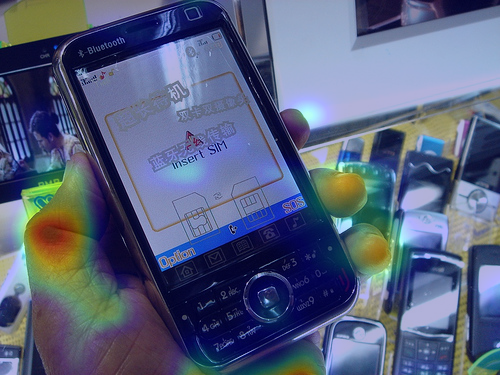

Rank correlation: -0.024271367955430282
San2 attention:


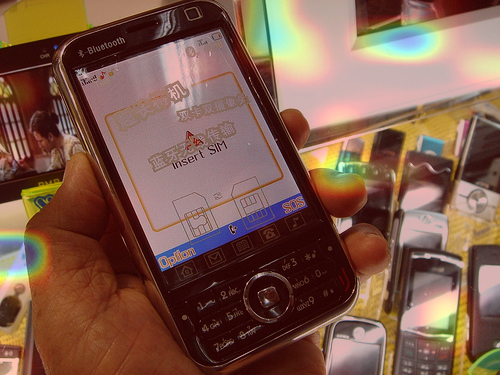

Rank correlation: 0.04676339181031931
Human attention:


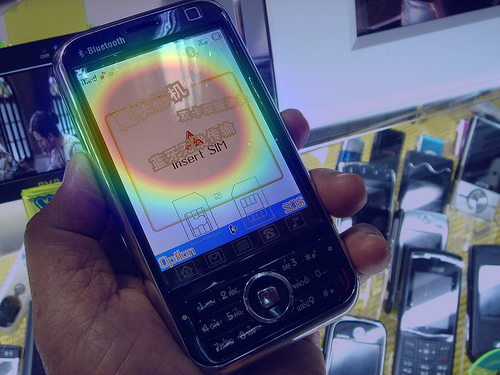

Question ID: 2242570
Question: Are the people happy?
HieCoAttentionVQA attention:


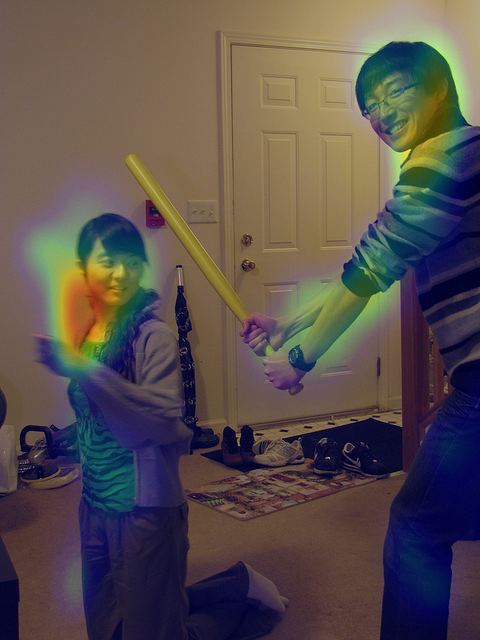

Rank correlation: -0.06023147870760345
San2 attention:


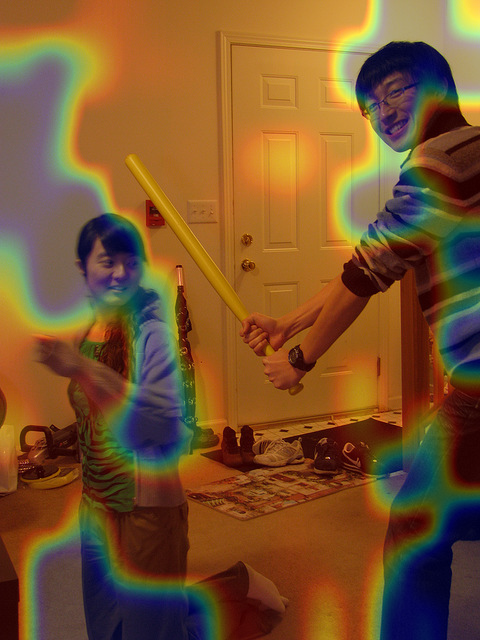

Rank correlation: 0.031015736360692252
Human attention:


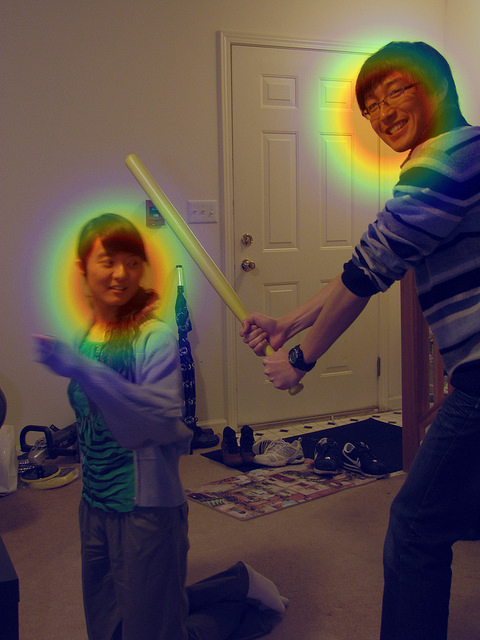

Question ID: 2828300
Question: How tall is the guy?
HieCoAttentionVQA attention:


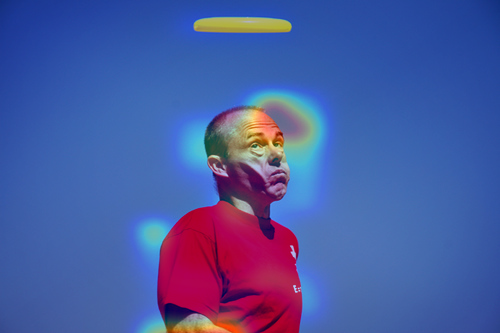

Rank correlation: 0.3841955772070104
San2 attention:


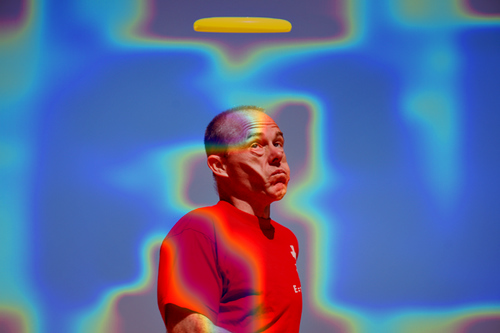

Rank correlation: 0.05281540264183906
Human attention:


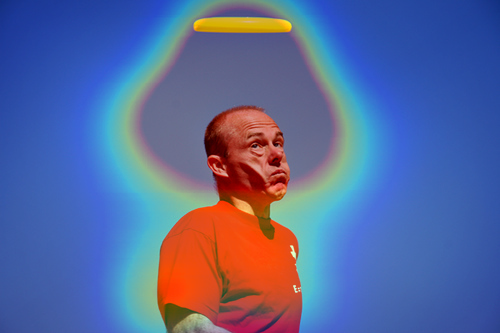

Question ID: 2555920
Question: Is this a school class?
HieCoAttentionVQA attention:


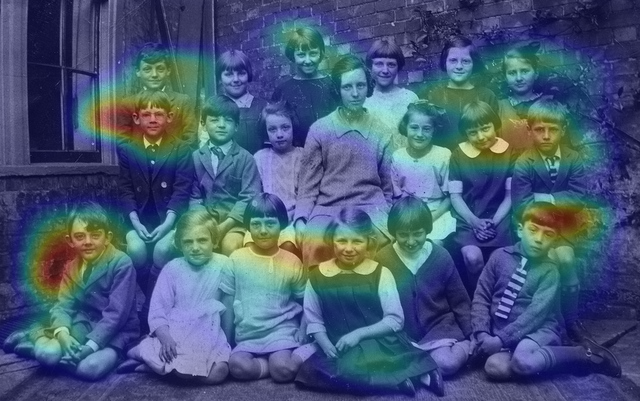

Rank correlation: 0.4628835952165003
San2 attention:


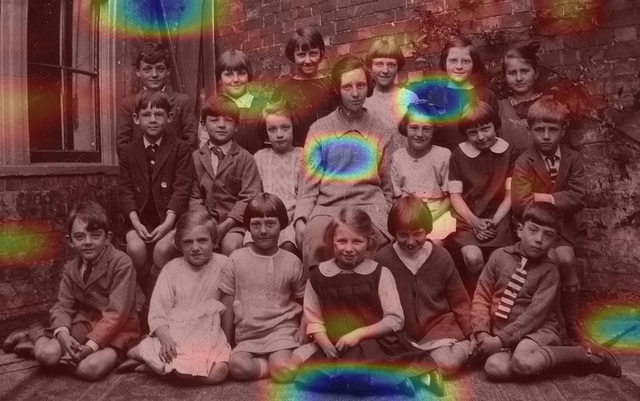

Rank correlation: 0.051965841787959016
Human attention:


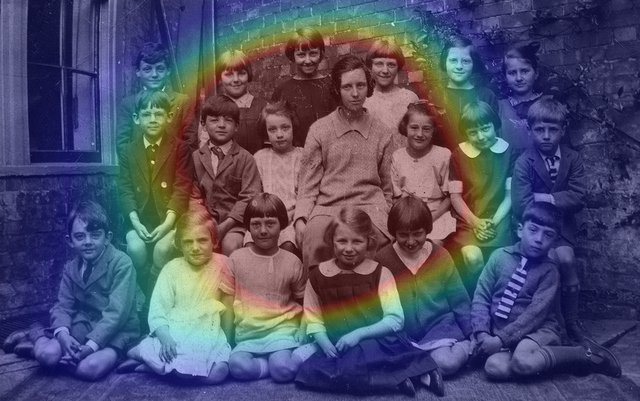

Question ID: 1134610
Question: Is this animal alive?
HieCoAttentionVQA attention:


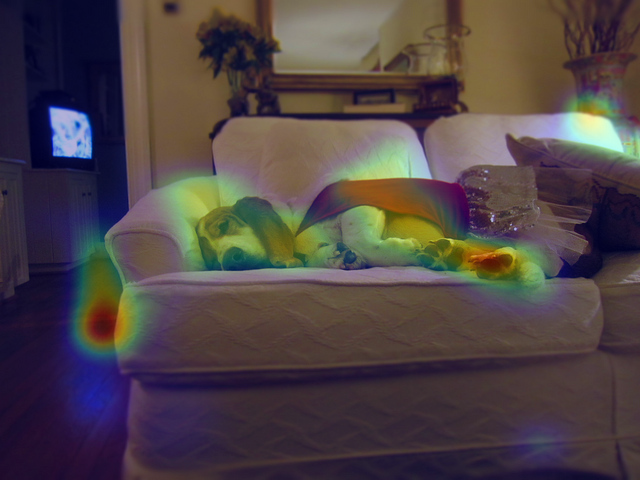

Rank correlation: 0.44312882837448614
San2 attention:


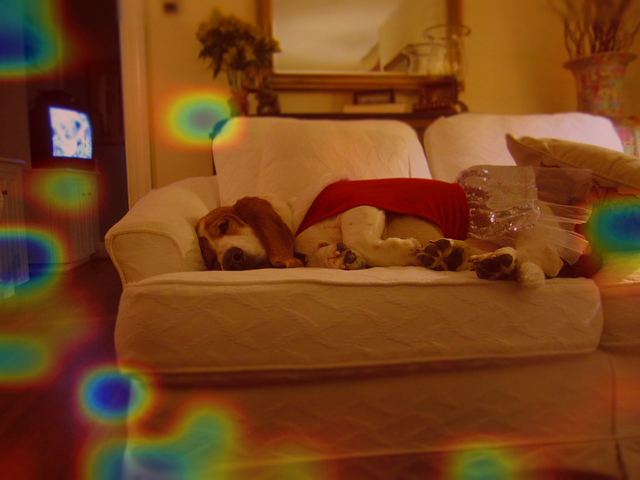

Rank correlation: 0.055141950301940565
Human attention:


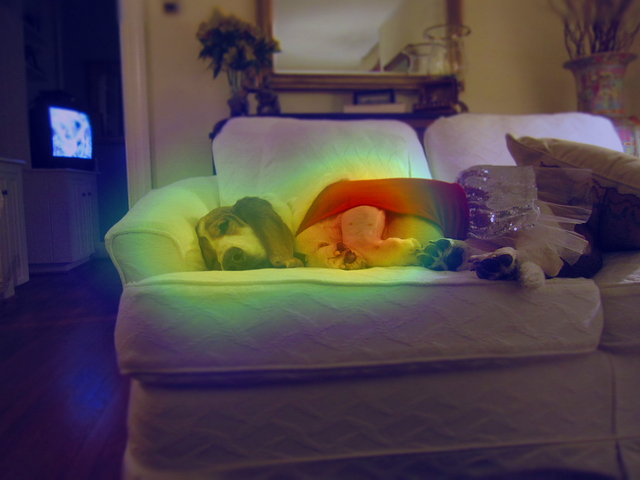

Question ID: 3995670
Question: Is the train moving?
HieCoAttentionVQA attention:


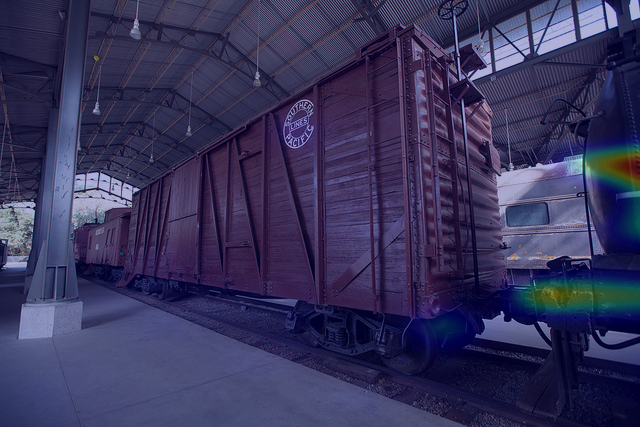

Rank correlation: 0.11976840033461611
San2 attention:


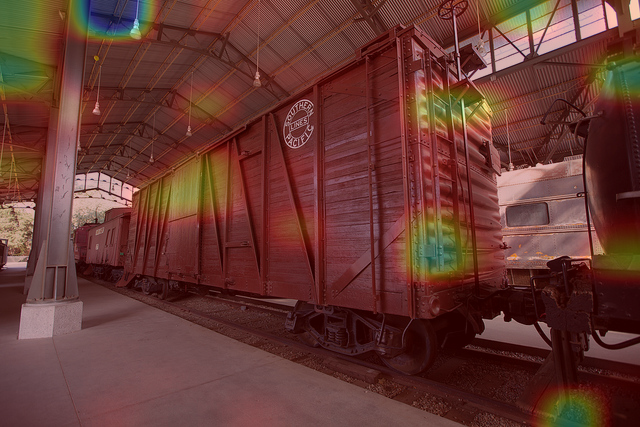

Rank correlation: 0.03767844092543285
Human attention:


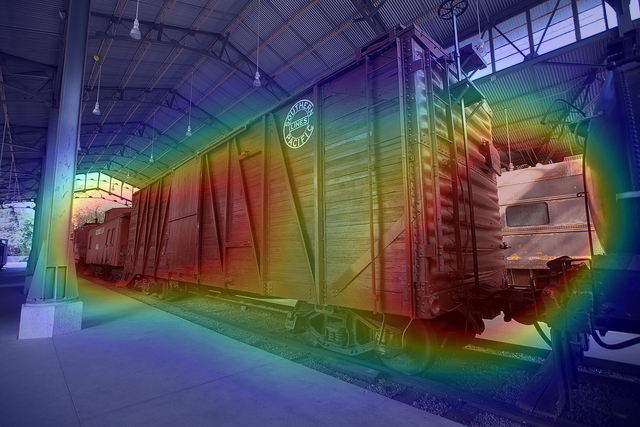

Question ID: 3426330
Question: What is the girl in red holding?
HieCoAttentionVQA attention:


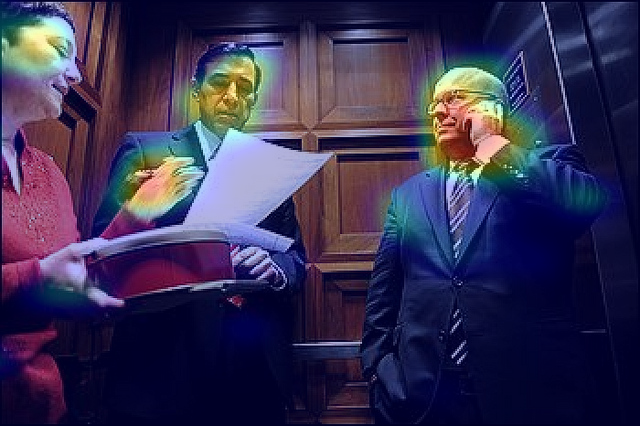

Rank correlation: 0.3218931243004203
San2 attention:


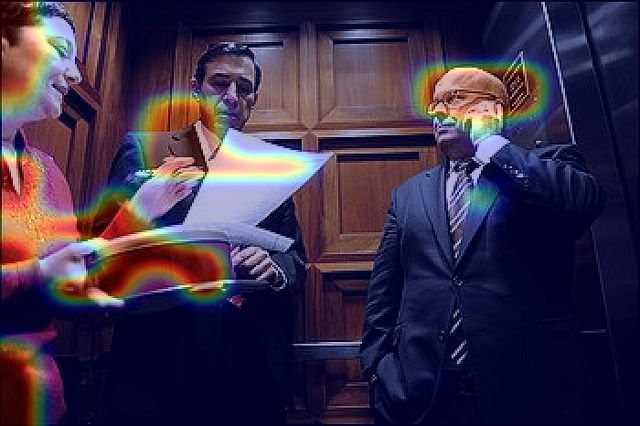

Rank correlation: 0.028770505183155604
Human attention:


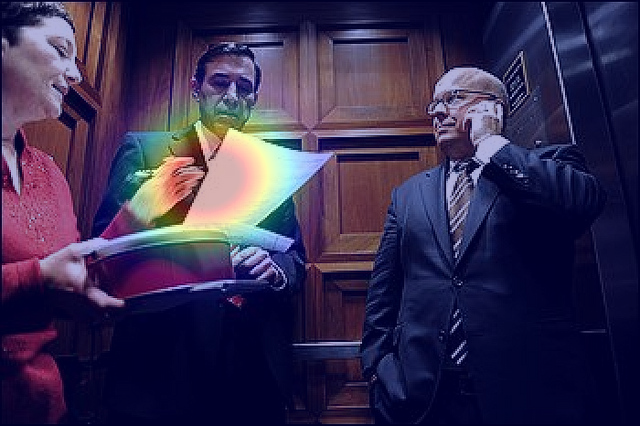

Question ID: 1394720
Question: Is there a hole in the umbrella?
HieCoAttentionVQA attention:


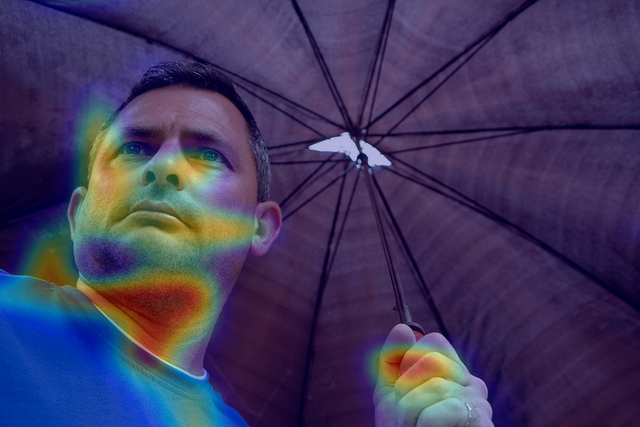

Rank correlation: 0.13139544826509922
San2 attention:


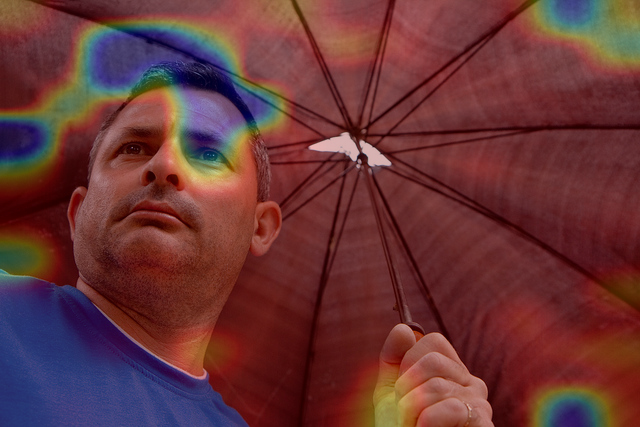

Rank correlation: 0.05300660327376126
Human attention:


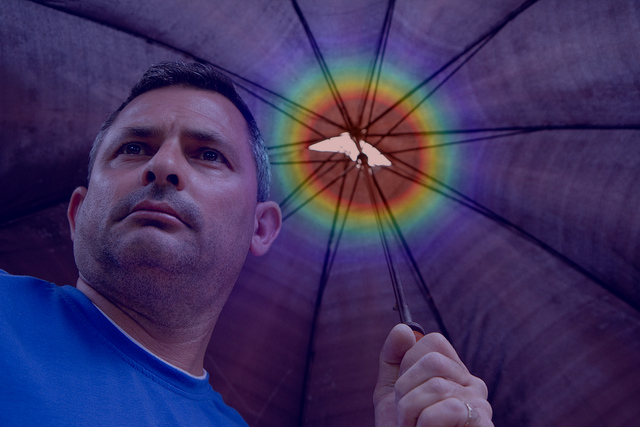

Question ID: 4794400
Question: What is the white object behind the cat?
HieCoAttentionVQA attention:


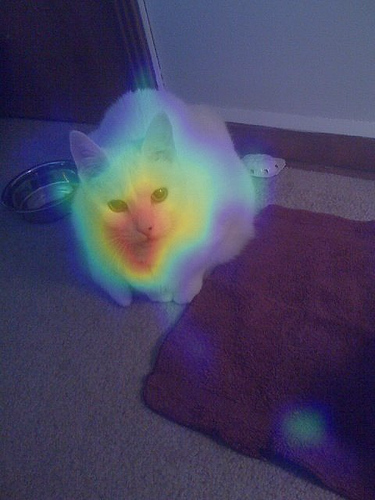

Rank correlation: 0.47261872433552904
San2 attention:


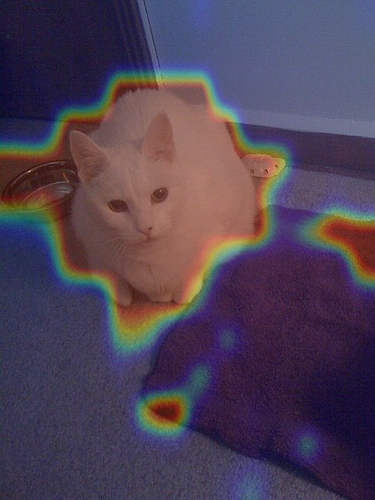

Rank correlation: 0.023655965475635022
Human attention:


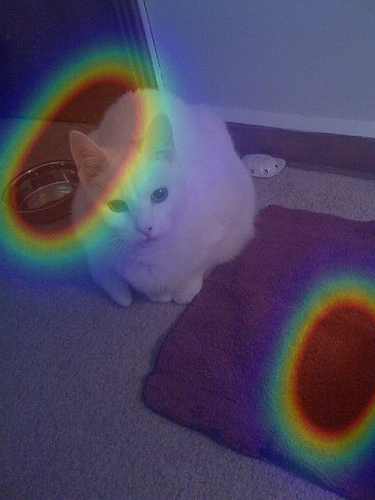

Question ID: 1210410
Question: What color is the duck's beak?
HieCoAttentionVQA attention:


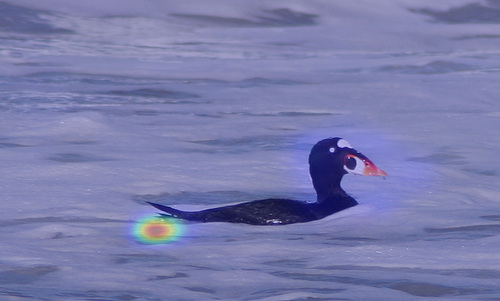

Rank correlation: 0.1863831557669902
San2 attention:


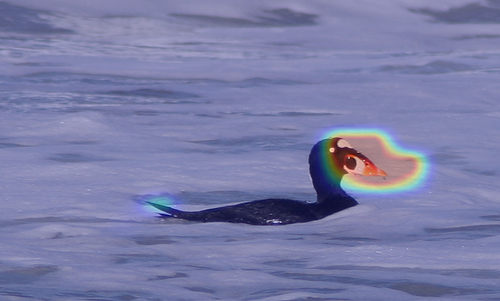

Rank correlation: 0.012161446464363554
Human attention:


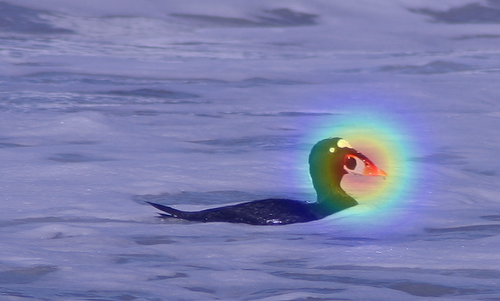

Question ID: 1951790
Question: How many lights are on the ceiling?
HieCoAttentionVQA attention:


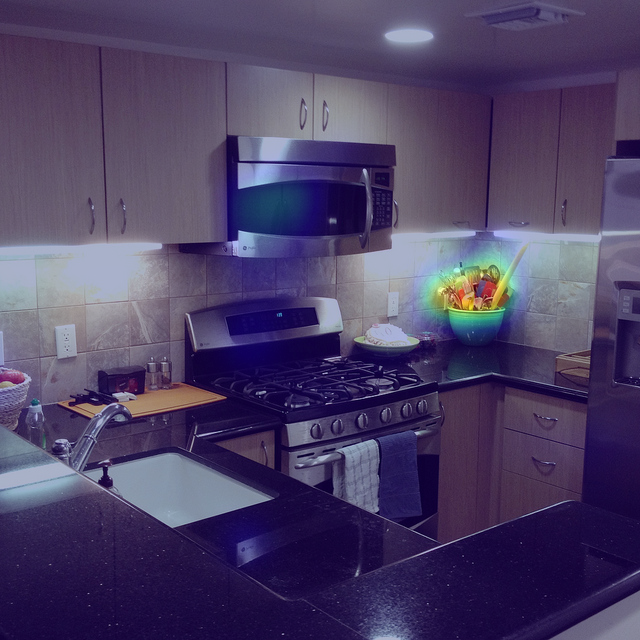

Rank correlation: 0.18528646638321775
San2 attention:


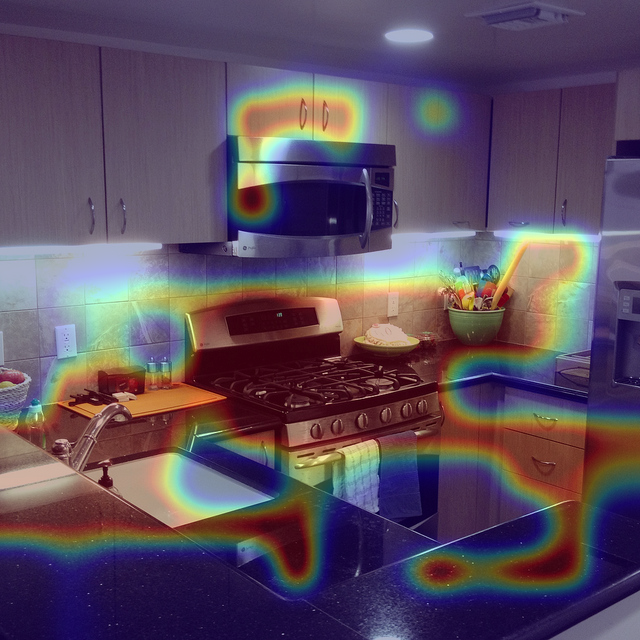

Rank correlation: -0.0013975390919137006
Human attention:


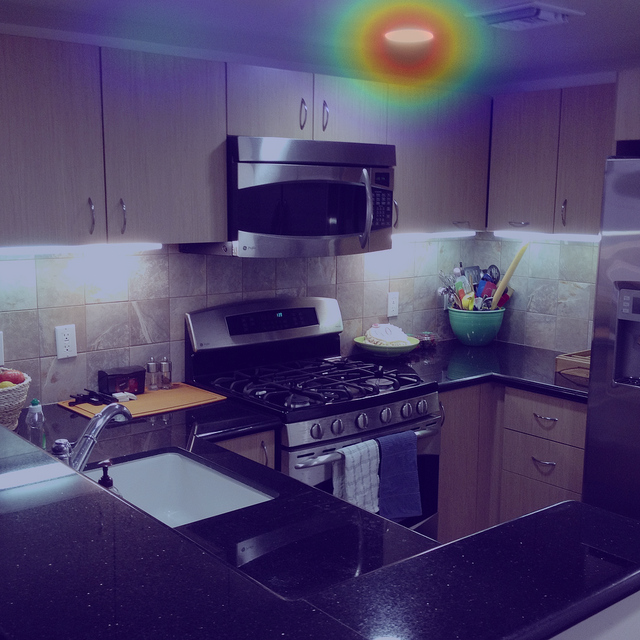

Question ID: 448560
Question: Why are the dogs laying in?
HieCoAttentionVQA attention:


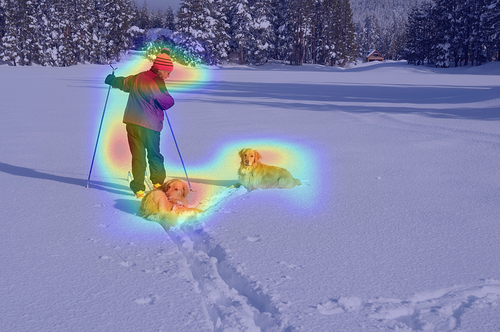

Rank correlation: 0.3517262448340671
San2 attention:


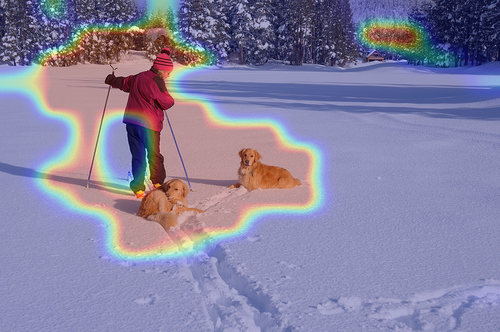

Rank correlation: 0.049755648640686885
Human attention:


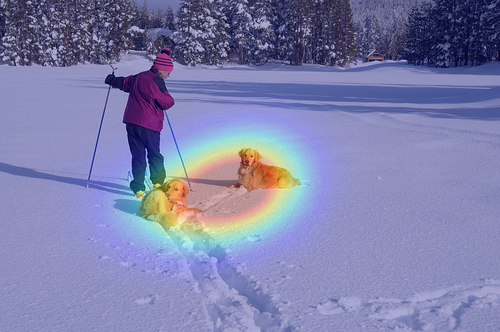

Question ID: 4180020
Question: What is on the building roof?
HieCoAttentionVQA attention:


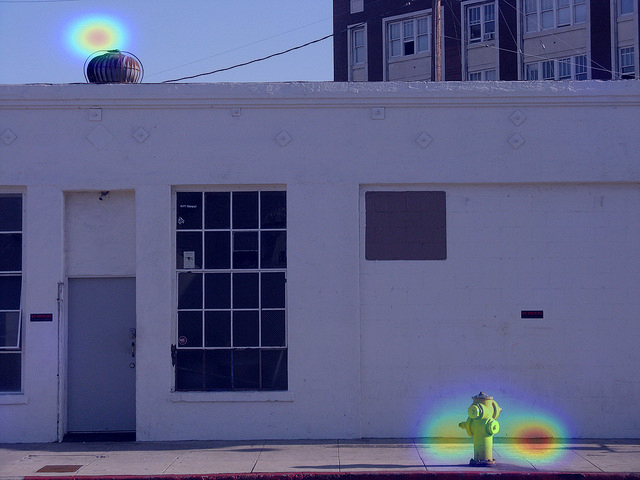

Rank correlation: -0.01600787351461364
San2 attention:


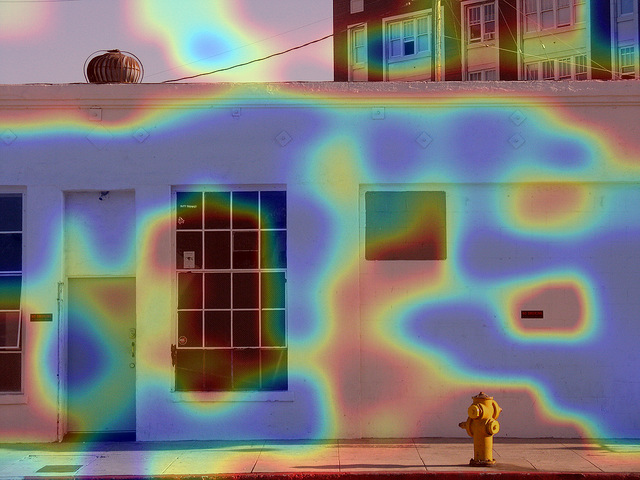

Rank correlation: 0.017612564610012812
Human attention:


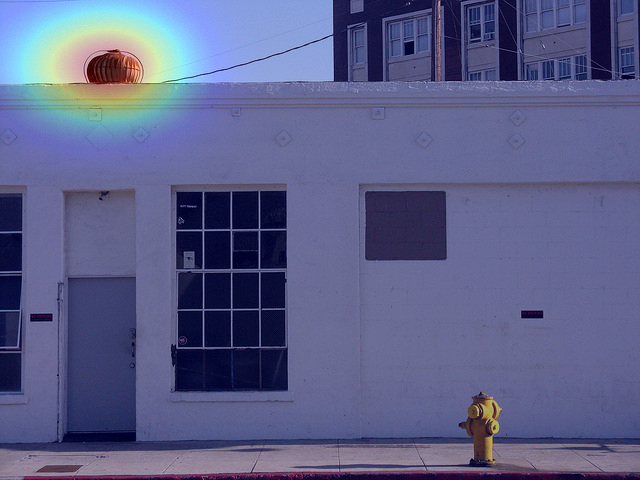

Question ID: 5326900
Question: Is the woman playing a video game?
HieCoAttentionVQA attention:


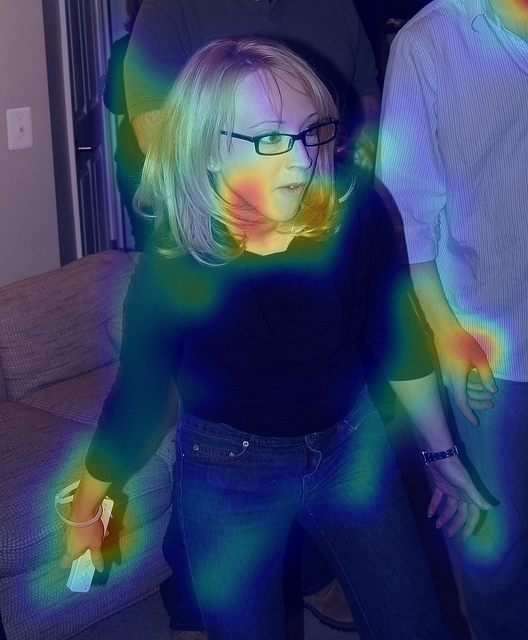

Rank correlation: 0.48257297934534116
San2 attention:


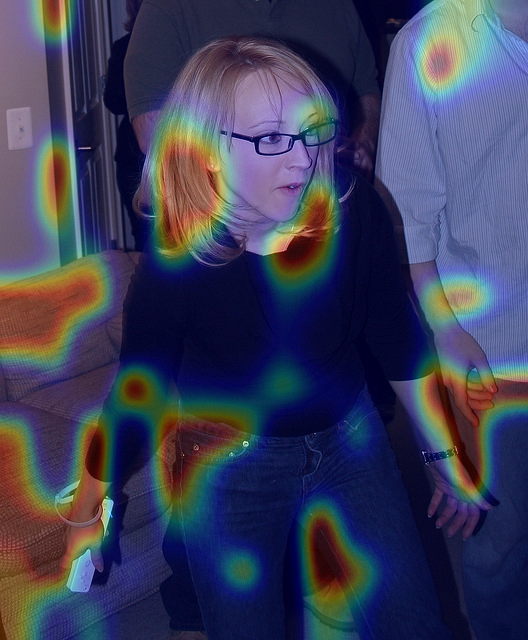

Rank correlation: 0.018253668928388124
Human attention:


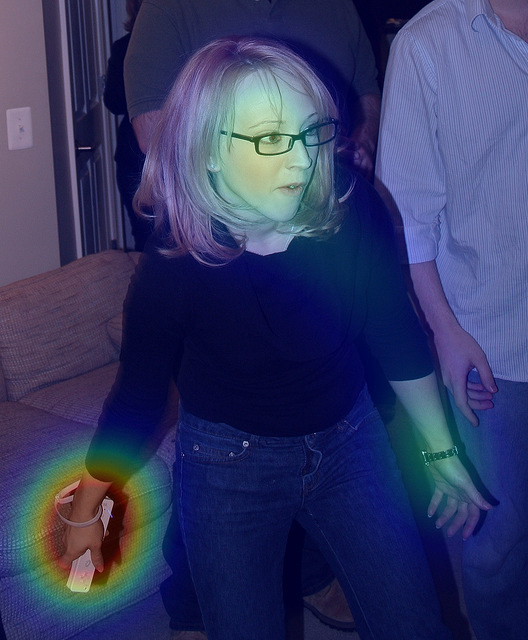

Question ID: 5636150
Question: What is the lady holding?
HieCoAttentionVQA attention:


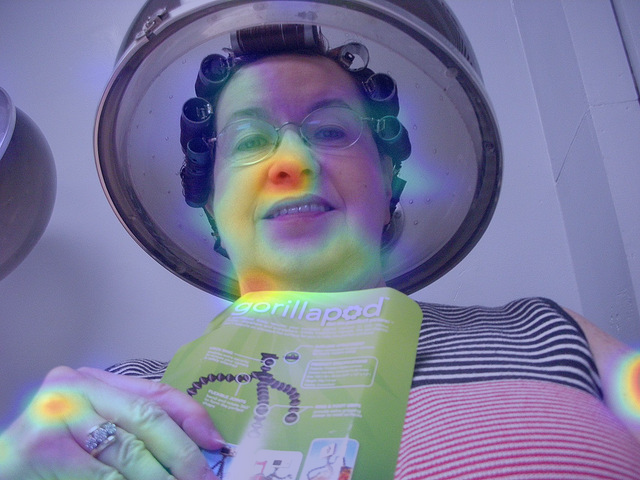

Rank correlation: 0.11318147751668806
San2 attention:


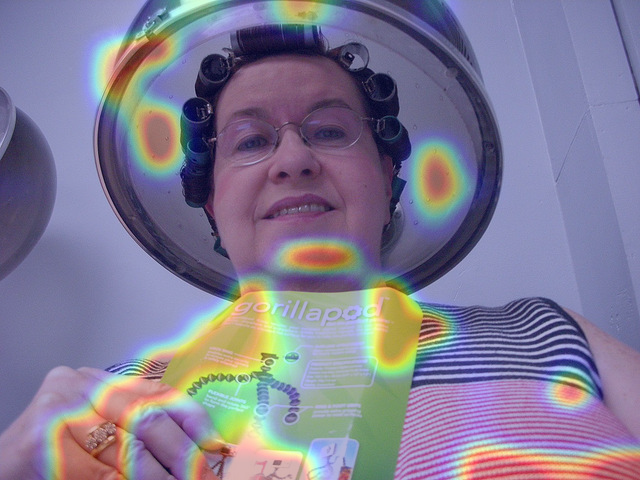

Rank correlation: 0.03582646085494331
Human attention:


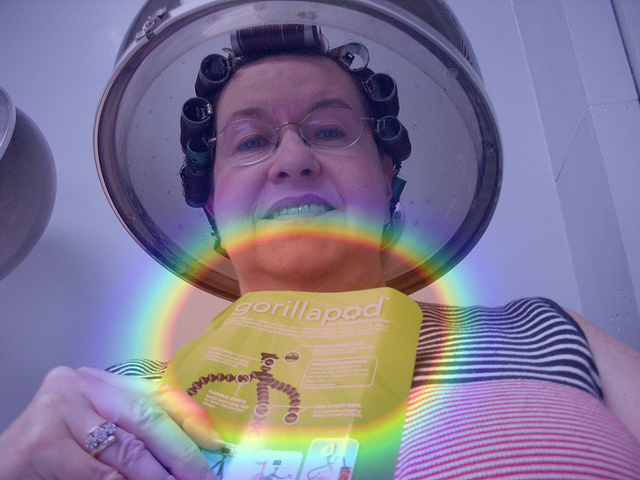

Question ID: 698420
Question: Is the door open or closed?
HieCoAttentionVQA attention:


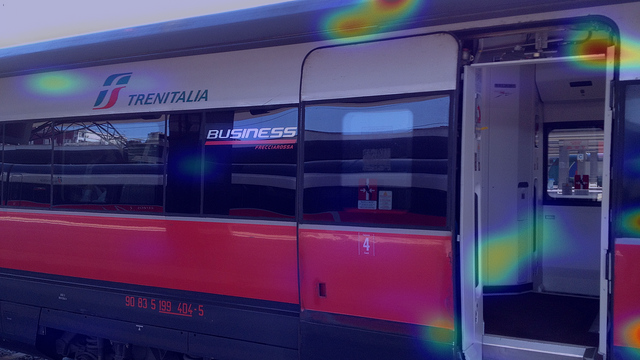

Rank correlation: -0.004929900647702584
San2 attention:


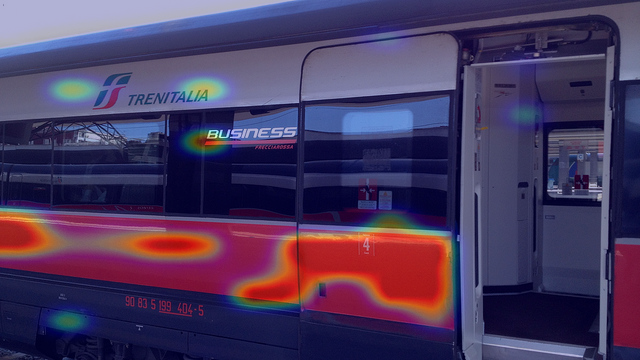

Rank correlation: 0.018307346284296203
Human attention:


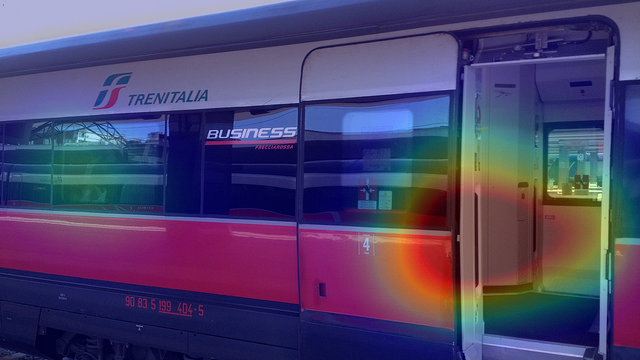

Question ID: 3502140
Question: What does the sign say?
HieCoAttentionVQA attention:


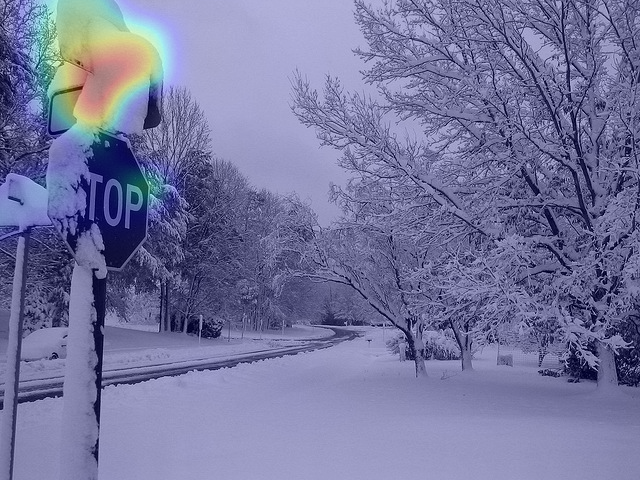

Rank correlation: -0.010929696012375305
San2 attention:


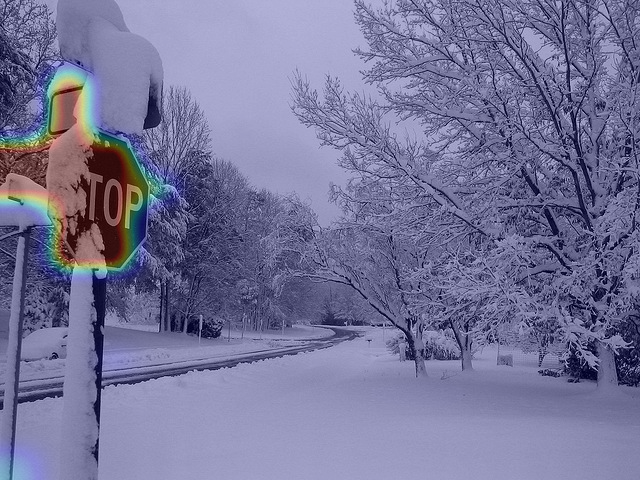

Rank correlation: 0.026679360532189004
Human attention:


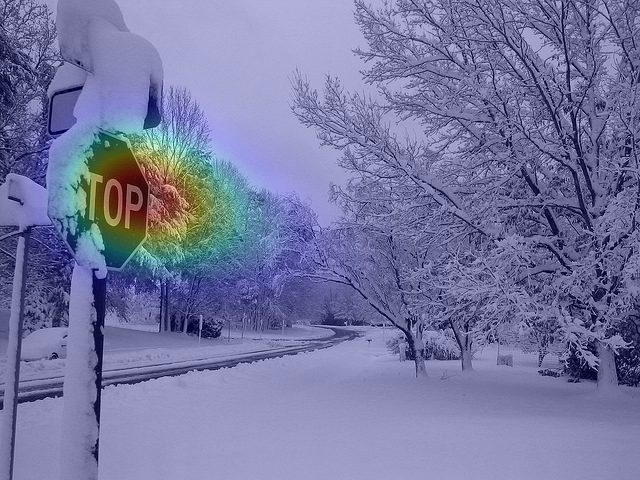

Question ID: 2906180
Question: Will the lady hit the ball?
HieCoAttentionVQA attention:


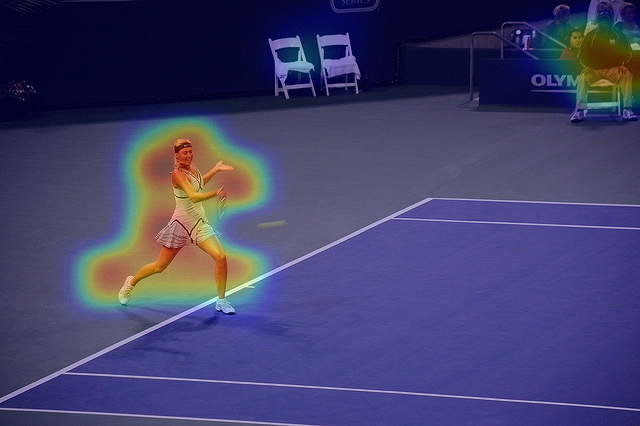

Rank correlation: 0.15549042298888532
San2 attention:


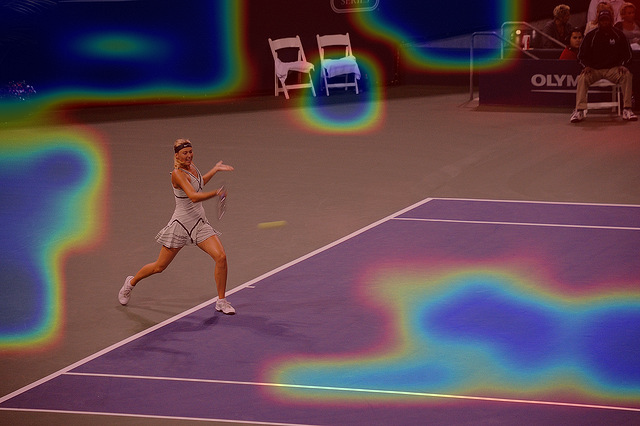

Rank correlation: 0.05289834148383184
Human attention:


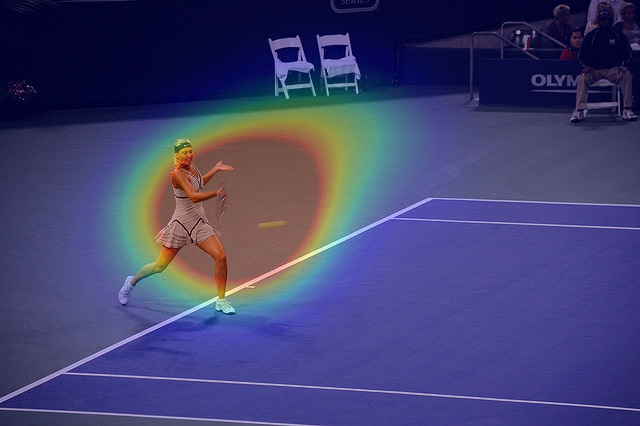

Question ID: 1906760
Question: What is in the left of the picture?
HieCoAttentionVQA attention:


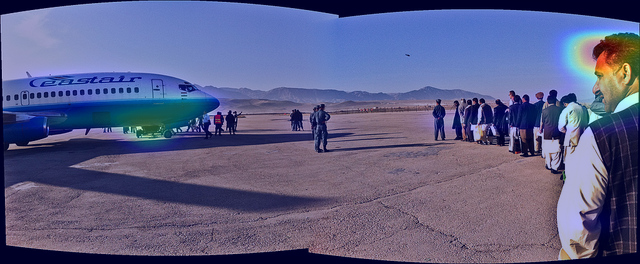

Rank correlation: 0.29790170013316675
San2 attention:


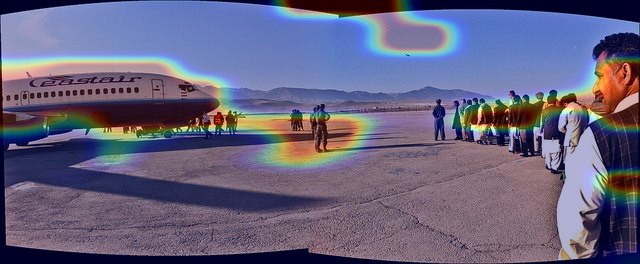

Rank correlation: 0.028097807624114107
Human attention:


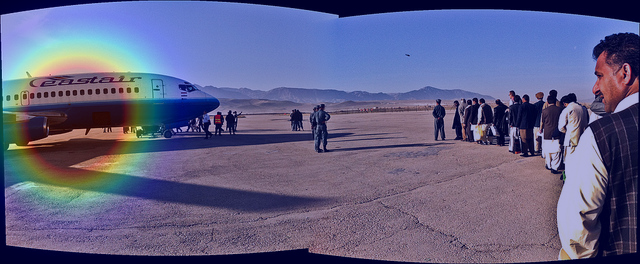

Question ID: 5615700
Question: How many of the traffic signals are illuminated?
HieCoAttentionVQA attention:


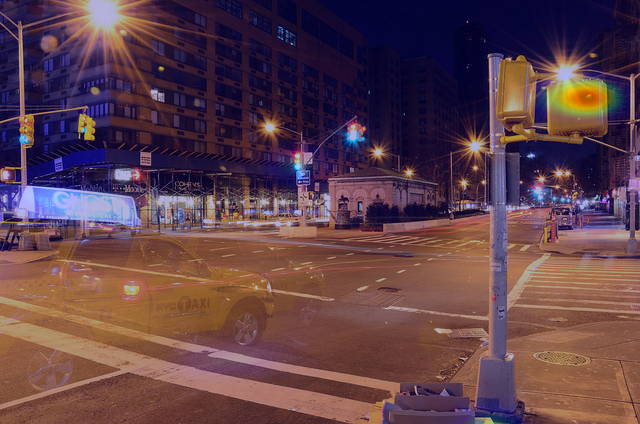

Rank correlation: 0.17013424925205645
San2 attention:


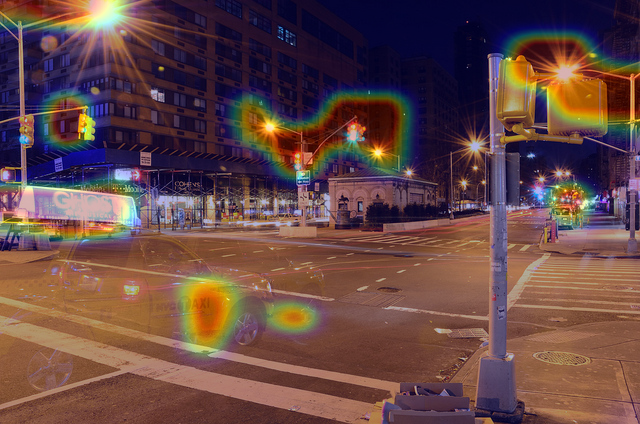

Rank correlation: 0.03846910080683794
Human attention:


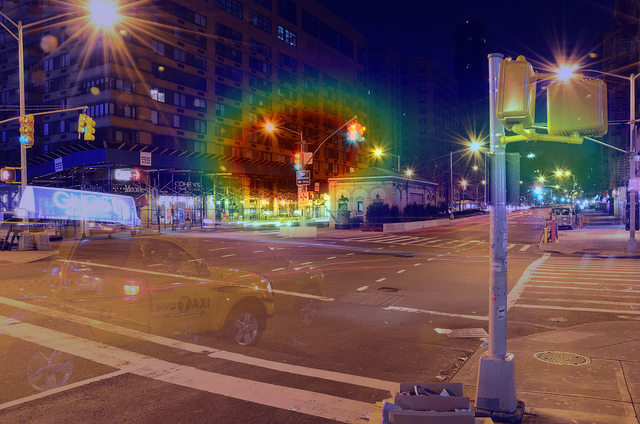

In [146]:
qids_list = list(intersect_all_qids)
n_examples = 20
for i in range(n_examples):
    compare_maps(qids_list[i])